In [1]:
usuario.close()

NameError: name 'usuario' is not defined

In [2]:
#Abrimos el txt con la informacion de los usuarios de las cosas
usuario = open('usuario', 'r')
#El ftp de donde quiero descargar
FTPusuario='AVISO'

while True:
    line = usuario.readline()
    if line == '':
        break
    
    if FTPusuario in line:
        split = line.split(';') #Separamos los elementos por los ;

usuario.close() #Cerramos el archivo de usuarios
     
#Tomamos de la segunda columna que tiene el nombre del usuario
user=str(split[1])
#Tomamos de la tercera columna que tiene la contraseña
pw=str(split[2])

In [3]:
from ftplib import FTP

ftp = FTP('ftp.aviso.altimetry.fr') #ftp de donde quiero los datos
ftp.login(user, pw)  # 'usuario', 'contraseña'

'230 User cima_leyba logged in'

In [4]:
anio=input('Año entre 1993 a 2015 = ') #elegimos el año que queremos bajar 

Año entre 1993 a 2015 = 2014


In [5]:
ftp.cwd('/global/delayed-time/grids/msla/all-sat-merged/h/'+ anio) # Poner el directorio donde estan los datos
 

'250 CWD command successful'

In [6]:
files=[]
ListaDatos = ftp.nlst()  


In [111]:
ListaDatosSelec=[]

for i in ListaDatos:
    if i.endswith('05_20140829.nc.gz'):
        
        localfile = open(i, 'wb') #Localfile es el nombre del archivo en la maquina local, puede ser el mismo nombre que filename o no.
        ftp.retrbinary('RETR ' + i, localfile.write, 1024)    # descarga el filename, lo descarga en localfile, velocidad de descarga           



In [125]:
#descomprimo archivo
import gzip

with gzip.open('dt_global_allsat_msla_h_20140105_20140829.nc.gz', 'rb') as f:
    nc_sla = f.read()


b'CDF\x01\x00\x00\x00\x00\x00\x00\x00\n\x00\x00\x00\x04\x00\x00\x00\x04time\x00\x00\x00\x01\x00\x00\x00\x03lat\x00\x00\x00\x02\xd0\x00\x00\x00\x03lon\x00\x00\x00\x05\xa0\x00\x00\x00\x02nv\x00\x00\x00\x00\x00\x02\x00\x00\x00\x0c\x00\x00\x00+\x00\x00\x00\x0bConventions\x00\x00\x00\x00\x02\x00\x00\x00\x06CF-1.6\x00\x00\x00\x00\x00\x14Metadata_Conventions\x00\x00\x00\x02\x00\x00\x00\x1eUnidata Dataset Discovery v1.0\x00\x00\x00\x00\x00\rcdm_data_type\x00\x00\x00\x00\x00\x00\x02\x00\x00\x00\x04Grid\x00\x00\x00\x07comment\x00\x00\x00\x00\x02\x00\x00\x009Sea Level Anomalies referenced to the [1993, 2012] period\x00\x00\x00\x00\x00\x00\x07contact\x00\x00\x00\x00\x02\x00\x00\x00#servicedesk.cmems@mercator-ocean.eu\x00\x00\x00\x00\rcreator_email\x00\x00\x00\x00\x00\x00\x02\x00\x00\x00#servicedesk.cmems@mercator-ocean.eu\x00\x00\x00\x00\x0ccreator_name\x00\x00\x00\x02\x00\x00\x00*CMEMS - Sea Level Thematic Assembly Center\x00\x00\x00\x00\x00\x0bcreator_url\x00\x00\x00\x00\x02\x00\x00\x00\x1bhttp:

In [28]:
# Abrir Netcdf 

from netCDF4 import Dataset 
import numpy as np 

dataset = Dataset('dt_global_allsat_msla_h_20140105_20140829_v2.nc', mode='r') #Ver tipo de netcdf 

print(dataset.file_format) 
#Dimensiones 
dataset.dimensions.keys() 
#Variables del netcdf 
dataset.variables.keys() 

NETCDF3_CLASSIC


odict_keys(['time', 'lat', 'lat_bnds', 'lon', 'lon_bnds', 'crs', 'nv', 'sla', 'err'])

In [21]:
#Ver informacion de la variable
dataset.variables['sla']

<class 'netCDF4._netCDF4.Variable'>
int32 sla(time, lat, lon)
    _FillValue: -2147483647
    coordinates: lon lat
    grid_mapping: crs
    long_name: Sea Level Anomalies
    scale_factor: 0.0001
    standard_name: sea_surface_height_above_sea_level
    units: m
unlimited dimensions: 
current shape = (1, 720, 1440)
filling off

In [22]:
#Ver informacion de la variable
dataset.variables['time']

<class 'netCDF4._netCDF4.Variable'>
float32 time(time)
    axis: T
    calendar: gregorian
    long_name: Time
    standard_name: time
    units: days since 1950-01-01 00:00:00
unlimited dimensions: 
current shape = (1,)
filling off

In [29]:
# EXtraemos las variables

lons = dataset.variables['lon'][:]
lats = dataset.variables['lat'][:]
sla = dataset.variables['sla'][:]
time = dataset.variables['time'][:]

dataset.close() # Cierra netcdf

05-January-2014


/home/ines/anaconda3/lib/python3.5/site-packages/mpl_toolkits/basemap/__init__.py:3644: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
  xx = x[x.shape[0]/2,:]


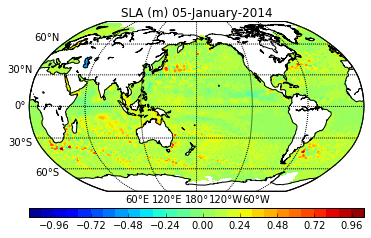

In [33]:
# Pasar a fecha calendario
import datetime
day = time[0]

date = datetime.datetime(1950, 1, 1) + datetime.timedelta(float(day)) #This assumes that the year is 2007

#Pasamos al formato que queremos (buscar documentación strftime)
fecha=date.strftime("%d-%B-%Y")
print(fecha)

from mpl_toolkits.basemap import Basemap
import matplotlib.pyplot as plt

#Con esto muestra el gráfico dentro de esta pantalla y no aparte
%matplotlib inline

# create Basemap instance for Robinson projection.
m = Basemap(projection='robin',lon_0=0.5*(lons[0]+lons[-1]))
# compute map projection coordinates for lat/lon grid.
x, y = m(*np.meshgrid(lons,lats))
# make filled contour plot.
cs = m.contourf(x,y,sla[0,:,:],30,cmap=plt.cm.jet)
m.drawcoastlines() # draw coastlines
m.drawmapboundary() # draw a line around the map region
m.drawparallels(np.arange(-90.,120.,30.),labels=[1,0,0,0]) # draw parallels
m.drawmeridians(np.arange(0.,420.,60.),labels=[0,0,0,1]) # draw meridians
plt.title('SLA (m) ' + fecha) # add a title
cbar = m.colorbar(cs, location='bottom', pad="10%") #Agregamos la barra de colores
plt.show()


In [18]:
type(time)

numpy.ndarray

In [26]:
print(day)

23380.0


In [ ]:
from ftplib import FTP

ftp = FTP('ftp.aviso.altimetry.fr')

ftp.login(user, pw)  # 'usuario', 'contraseña'

ftp.cwd('/global/delayed-time/grids/msla/all-sat-merged/h/2015')               # Poner el directorio donde estan los datos
ftp.retrlines('LIST')           # Realiza una lista con los archivos que se encuentran

filename='sst.mnmean.v4.nc'

localfile = open(filename, 'wb') #Localfile es el nombre del archivo en la maquina local, puede ser el mismo nombre que filename o no.
ftp.retrbinary('RETR ' + filename, localfile.write, 1024)    # descarga el filename, lo descarga en localfile, velocidad de descarga           

localfile.close()

ftp.close()